The objective of the following article is to obtain a step-by-step guide on building the `ADIDA Model` using `ADIDA` with `Statsforecast`.

During this walkthrough, we will become familiar with the main `StatsForecast` class and some relevant methods such as `StatsForecast.plot`, `StatsForecast.forecast` and `StatsForecast.cross_validation` in other.

Let's start!!!

<a class="anchor" id="0.1"></a>
# **Table of Contents** 


1.	[Introduction](#1)
2.	[ADIDA Model](#2)
3.	[Installing Statsforecast](#3)
4.	[Loading libraries and data](#4)
5.	[Explore Data with the plot method](#5)
6.	[Split the data into training and testing](#6)
7.	[Implementation of Theta with StatsForecast](#7)
8.	[Evaluate the model’s performance](#8)
9.	[Evaluate the model](#9)
10. [References](#10)

# **1. Introduction** <a class="anchor" id="1"></a>

[Table of Contents](#0)

The Aggregate-Disaggregate Intermittent Demand Approach (ADIDA) is a forecasting method that is used to predict the demand for products that exhibit intermittent demand patterns. Intermittent demand patterns are characterized by a large number of zero observations, which can make forecasting challenging.

The ADIDA method uses temporal aggregation to reduce the number of zero observations and mitigate the effect of the variance observed in the intervals. The method uses equally sized time buckets to perform non-overlapping temporal aggregation and predict the demand over a pre-specified lead time. The time bucket is set equal to the mean inter-demand interval, which is the average time between two consecutive non-zero observations.

The method uses the Simple Exponential Smoothing (SES) technique to obtain the forecasts. SES is a popular time series forecasting technique that is commonly used for its simplicity and effectiveness in producing accurate forecasts.

The ADIDA method has several advantages. It is easy to implement and can be used for a wide range of intermittent demand patterns. The method also provides accurate forecasts and can be used to predict the demand over a pre-specified lead time.

However, the ADIDA method has some limitations. The method assumes that the time buckets are equally sized, which may not be the case for all intermittent demand patterns. Additionally, the method may not be suitable for time series data with complex patterns or trends.

Overall, the ADIDA method is a useful forecasting technique for intermittent demand patterns that can help mitigate the effect of zero observations and produce accurate demand forecasts.

# **2. ADIDA Model**
The ADIDA model is based on the Simple Exponential Smoothing (SES) method and uses temporal aggregation to handle the problem of intermittent demand. The mathematical development of the model can be summarized as follows:

Let St be the demand at time $t$, where $t = 1, 2, ..., T$. The mean inter-demand interval is denoted as MI, which is the average time between two consecutive non-zero demands. The time bucket size is set equal to MI.

The demand data is then aggregated into non-overlapping time buckets of size MI. Let Bt be the demand in bucket $t$, where $t = 1, 2, ..., T/MI$. The aggregated demand data can be represented as:

$$B_t = \sum S_t, for (t-1)*MI + 1 ≤ j ≤ t*MI$$

The SES method is then applied to the aggregated demand data to obtain the forecasts. The forecast for bucket $t$ is denoted as $F_t$. The SES method involves estimating the level $L_t$ at time t based on the actual demand $D_t$ at time t and the estimated level at the previous time period, $L_{t-1}$, using the following equation:

$$L_t = \alpha * D_t + (1 - α) * L_{t-1}$$

where $\alpha$ is the smoothing parameter that controls the weight given to the current demand value.

The forecast for bucket $t$ is then obtained by using the estimated level at the previous time period, $L_{t-1}$, as follows:

$$F_t = L_{t-1}$$

The forecasts are then disaggregated to obtain the demand predictions for the original time period. Let $Y_t$ be the demand prediction at time $t$. The disaggregation can be performed using the following equation:

$$Y_t = F_t / MI, for (t-1)*MI + 1 ≤ j ≤ t*MI$$

# **3. Installing Statsforecast** <a class="anchor" id="3"></a>

[Table of Contents](#0.1)

* using pip:

`pip install statsforecast`

* using with conda:

`conda install -c conda-forge statsforecast`



¡Warning!

We are constantly updating StatsForecast, so we suggest fixing the version to avoid issues. 

`pip install statsforecast=="1.0.0"`

# **4. Loading libraries and data** <a class="anchor" id="4"></a>

[Table of Contents](#0.1)

In [1]:
# Handling and processing of Data
# ==============================================================================
import numpy as np
import pandas as pd

import scipy.stats as stats

# Handling and processing of Data for Date (time)
# ==============================================================================
import datetime
import time
from datetime import datetime, timedelta

# 
# ==============================================================================
from statsmodels.tsa.stattools import adfuller
import statsmodels.api as sm
import statsmodels.tsa.api as smt

In [2]:
# Plot
# ==============================================================================
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
import plotly.express as px
import plotly.graph_objects as go
import plotly.tools.mlp
plt.style.use('grayscale') # fivethirtyeight  grayscale  classic
plt.rcParams['lines.linewidth'] = 1.5
dark_style = {
    'figure.facecolor': '#008080',  # #212946
    'axes.facecolor': '#008080',
    'savefig.facecolor': '#008080',
    'axes.grid': True,
    'axes.grid.which': 'both',
    'axes.spines.left': False,
    'axes.spines.right': False,
    'axes.spines.top': False,
    'axes.spines.bottom': False,
    'grid.color': '#000000',  #2A3459
    'grid.linewidth': '1',
    'text.color': '0.9',
    'axes.labelcolor': '0.9',
    'xtick.color': '0.9',
    'ytick.color': '0.9',
    'font.size': 12 }
plt.rcParams.update(dark_style)
# Define the plot size
# ==============================================================================
from pylab import rcParams
rcParams['figure.figsize'] = (18,7)

# Hide warnings
# ==============================================================================
from pylab import rcParams
import warnings
warnings.filterwarnings("ignore")

In [3]:
df=pd.read_csv("https://raw.githubusercontent.com/Naren8520/Serie-de-tiempo-con-Machine-Learning/main/Data/PJME_hourly.csv", )
df.head()

,Datetime,PJME_MW
0,2002-12-31 01:00:00,26498.0
1,2002-12-31 02:00:00,25147.0
2,2002-12-31 03:00:00,24574.0
3,2002-12-31 04:00:00,24393.0
4,2002-12-31 05:00:00,24860.0


The input to StatsForecast is always a data frame in long format with three columns: unique_id, ds and y:

* The `unique_id` (string, int or category) represents an identifier for the series.

* The `ds` (datestamp) column should be of a format expected by Pandas, ideally YYYY-MM-DD for a date or YYYY-MM-DD HH:MM:SS for a timestamp.

* The `y` (numeric) represents the measurement we wish to forecast.

In [4]:
df["unique_id"]="1"
df.columns=["ds", "y", "unique_id"]
df.head()

,ds,y,unique_id
0,2002-12-31 01:00:00,26498.0,1
1,2002-12-31 02:00:00,25147.0,1
2,2002-12-31 03:00:00,24574.0,1
3,2002-12-31 04:00:00,24393.0,1
4,2002-12-31 05:00:00,24860.0,1


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145366 entries, 0 to 145365
Data columns (total 3 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   ds         145366 non-null  object 
 1   y          145366 non-null  float64
 2   unique_id  145366 non-null  object 
dtypes: float64(1), object(2)
memory usage: 3.3+ MB


We can see that our time variable `(ds)` is in an object format, we need to convert to a date format

In [6]:
# Convert to a datetime format
from datetime import datetime
df["ds"] = pd.to_datetime(df["ds"])

# sort by date & time
df.sort_values(by=['ds'], axis=0, ascending=True, inplace=True)

In [7]:
df.head()

,ds,y,unique_id
8734,2002-01-01 01:00:00,30393.0,1
8735,2002-01-01 02:00:00,29265.0,1
8736,2002-01-01 03:00:00,28357.0,1
8737,2002-01-01 04:00:00,27899.0,1
8738,2002-01-01 05:00:00,28057.0,1


In [8]:
# deduplicate, only keeping the last measurement per datetime
df.drop_duplicates(subset='ds', keep='last', inplace=True)

In [9]:
# let's see if we have a continuous dataset
df = df.set_index('ds')
print(f'df.index.freq is set to: {df.index.freq}')

df.index.freq is set to: None


The fact our datetime index's frequency is set to None is an indication there are some missing data points somewhere (otherwise Python could deduce it). Let's compare it to an uninterruped custom date range.

In [10]:
# custom range
date_range = pd.date_range(start=min(df.index), 
                           end=max(df.index), 
                           freq='H')


In [11]:
print(f'The difference in length between the custom date range and our dataset is {(len(date_range)-len(df))}:')
print(date_range.difference(df.index))

The difference in length between the custom date range and our dataset is 30:
DatetimeIndex(['2002-04-07 03:00:00', '2002-10-27 02:00:00',
               '2003-04-06 03:00:00', '2003-10-26 02:00:00',
               '2004-04-04 03:00:00', '2004-10-31 02:00:00',
               '2005-04-03 03:00:00', '2005-10-30 02:00:00',
               '2006-04-02 03:00:00', '2006-10-29 02:00:00',
               '2007-03-11 03:00:00', '2007-11-04 02:00:00',
               '2008-03-09 03:00:00', '2008-11-02 02:00:00',
               '2009-03-08 03:00:00', '2009-11-01 02:00:00',
               '2010-03-14 03:00:00', '2010-11-07 02:00:00',
               '2010-12-10 00:00:00', '2011-03-13 03:00:00',
               '2011-11-06 02:00:00', '2012-03-11 03:00:00',
               '2012-11-04 02:00:00', '2013-03-10 03:00:00',
               '2013-11-03 02:00:00', '2014-03-09 03:00:00',
               '2015-03-08 03:00:00', '2016-03-13 03:00:00',
               '2017-03-12 03:00:00', '2018-03-11 03:00:00'],
      

Let's reindex our dataset and then perform imputation.

In [12]:
# this will append the previously missing datetimes, and create null values in our target variable
df = df.reindex(date_range)

# we fill in the blanks with values that lie on a linear curve between existing data points
df['y'].interpolate(method='linear', inplace=True)

# now we have a neatly continuous datetime index
print(f'The df.index.freq is now: {df.index.freq}, indicating that we no longer have missing instances')

The df.index.freq is now: <Hour>, indicating that we no longer have missing instances


## Extracting Time Features
We can split up the date-timestamp column into its different components. This will allow us to find patterns for different groups.

In [13]:
df['dow'] = df.index.dayofweek
df['doy'] = df.index.dayofyear
df['year'] = df.index.year
df['month'] = df.index.month
df['quarter'] = df.index.quarter
df['hour'] = df.index.hour
df['weekday'] = df.index.day_name()
df['woy'] = df.index.weekofyear
df['dom'] = df.index.day # Day of Month
df['date'] = df.index.date 

# let's add the season number
df['season'] = df['month'].apply(lambda month_number: (month_number%12 + 3)//3)
df

,y,unique_id,dow,doy,year,month,quarter,hour,weekday,woy,dom,date,season
2002-01-01 01:00:00,30393.0,1,1,1,2002,1,1,1,Tuesday,1,1,2002-01-01,1
2002-01-01 02:00:00,29265.0,1,1,1,2002,1,1,2,Tuesday,1,1,2002-01-01,1
2002-01-01 03:00:00,28357.0,1,1,1,2002,1,1,3,Tuesday,1,1,2002-01-01,1
2002-01-01 04:00:00,27899.0,1,1,1,2002,1,1,4,Tuesday,1,1,2002-01-01,1
2002-01-01 05:00:00,28057.0,1,1,1,2002,1,1,5,Tuesday,1,1,2002-01-01,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,44057.0,1,3,214,2018,8,3,20,Thursday,31,2,2018-08-02,3
2018-08-02 21:00:00,43256.0,1,3,214,2018,8,3,21,Thursday,31,2,2018-08-02,3
2018-08-02 22:00:00,41552.0,1,3,214,2018,8,3,22,Thursday,31,2,2018-08-02,3
2018-08-02 23:00:00,38500.0,1,3,214,2018,8,3,23,Thursday,31,2,2018-08-02,3


In [14]:
df.reset_index(inplace=True)


In [15]:
df

,index,y,unique_id,dow,doy,year,month,quarter,hour,weekday,woy,dom,date,season
0,2002-01-01 01:00:00,30393.0,1,1,1,2002,1,1,1,Tuesday,1,1,2002-01-01,1
1,2002-01-01 02:00:00,29265.0,1,1,1,2002,1,1,2,Tuesday,1,1,2002-01-01,1
2,2002-01-01 03:00:00,28357.0,1,1,1,2002,1,1,3,Tuesday,1,1,2002-01-01,1
3,2002-01-01 04:00:00,27899.0,1,1,1,2002,1,1,4,Tuesday,1,1,2002-01-01,1
4,2002-01-01 05:00:00,28057.0,1,1,1,2002,1,1,5,Tuesday,1,1,2002-01-01,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145387,2018-08-02 20:00:00,44057.0,1,3,214,2018,8,3,20,Thursday,31,2,2018-08-02,3
145388,2018-08-02 21:00:00,43256.0,1,3,214,2018,8,3,21,Thursday,31,2,2018-08-02,3
145389,2018-08-02 22:00:00,41552.0,1,3,214,2018,8,3,22,Thursday,31,2,2018-08-02,3
145390,2018-08-02 23:00:00,38500.0,1,3,214,2018,8,3,23,Thursday,31,2,2018-08-02,3


In [16]:
df.rename(columns={"index": "ds", }, inplace=True)

In [17]:
# plotting
fig = px.line(df,
              x='ds',
              y='y',
              title=f'Power Demand (MW) over time [{min(df.year)} - {max(df.year)}]')
fig.update_traces(line=dict(width=0.05))
fig.update_layout(xaxis_title='Date & Time (yyyy/mm/dd hh:MM)',
                  yaxis_title='Energy Demand [MW]')
fig.show()

We can definitely identify a seasonal pattern here. Counter-intuitively, though, no immediately apparent trend.

Date & Time Patterns

We can use our previously extracted date and time features to see if recurring patterns emerge from aggregated data. Take, for instance, the power demand throughout the day for each weekday:

In [18]:
# aggregated data
_ = df\
    .groupby(['hour', 'weekday'], as_index=False)\
    .agg({'y':'median'})

# plotting
fig = px.line(_, 
              x='hour', 
              y='y', 
              color='weekday', 
              title='Median Hourly Power Demand per Weekday')
fig.update_layout(xaxis_title='Hour',
                  yaxis_title='Energy Demand [MW]')
fig.show()

We can quickly tell demand for electricity is lower during the weekends, and dips a little sooner on friday afternoons.

In [19]:
# aggregated data
_ = df\
    .groupby(['hour', 'season'], as_index=False)\
    .agg({'y':'median'})

# plotting
fig = px.line(_,
              x='hour', 
              y='y', 
              color='season', 
              title='Median Hourly Power Demand per Season')
fig.update_layout(xaxis_title='Hour',
                  yaxis_title='Energy Demand [MW]')
fig.show()

## Decomposing the Time-Series
Data points over time can be interesting in the sense that their patterns are complemented by a trend (upward or downward) and/or seasonality. As we have established in our EDA, these aspects seem to play a role in this dataset.

Because the seasonal variation in our dataset looks constant over time, we will use the additive model for decomposition (as opposed to the multiplicative model, which is useful for cases where seasonal variation increases over time).

In [31]:
from plotly.subplots import make_subplots

In [34]:
from statsmodels.tsa.seasonal import seasonal_decompose
import plotly.tools as tls

def plotSeasonalDecompose(
    x,
    model='additive',
    filt=None,
    period=None,
    two_sided=True,
    extrapolate_trend=0,
    title="Seasonal Decomposition"):

    """
    Plot time series decomposition
    :param x: Time series.
    
    See documentation of the remaining models here - 
        https://www.statsmodels.org/stable/generated/statsmodels.tsa.seasonal.seasonal_decompose.html
     
    Example - 
    import pandas as pd
    from datetime import datetime
    import PlotTimeSeries
    s = pd.DataFrame(list(range(1, 11))*10,
                    index=pd.date_range(start=datetime(2010,  1, 1), periods=100))
    fig = PlotTimeSeries.plotSeasonalDecompose(s)
    fig.show()
    """

    result = seasonal_decompose(
            x, model=model, filt=filt, period=period,
            two_sided=two_sided, extrapolate_trend=extrapolate_trend)
    fig = make_subplots(
            rows=4, cols=1,
            subplot_titles=["Observed", "Trend", "Seasonal", "Residuals"])
    
    fig.add_trace(
            go.Scatter(x=result.seasonal.index, y=result.observed, mode='lines'),
                row=1, col=1,
            )

    fig.add_trace(
            go.Scatter(x=result.trend.index, y=result.trend, mode='lines'),
                row=2, col=1,
            )

    fig.add_trace(
            go.Scatter(x=result.seasonal.index, y=result.seasonal, mode='lines'),
                row=3, col=1,
            )

    fig.add_trace(
            go.Scatter(x=result.resid.index, y=result.resid, mode='lines'),
                row=4, col=1,
            )

    return fig

In [47]:
plotSeasonalDecompose(
    df["y"],
    model="additive",
    period=24*365,
    
    title="Seasonal Decomposition")

# **6. Split the data into training and testing** <a class="anchor" id="6"></a>

[Table of Contents](#0.1)

Let's divide our data into sets
1. Data to train our `ADIDA Model`.
2. Data to test our model

For the test data we will use the last 30 hours to test and evaluate the performance of our model.

In [51]:
df=df[["ds","y","unique_id"]]

In [52]:
train = df[df.ds<='2018-08-01 18:00:00'] 
test = df[df.ds>'2018-08-01 18:00:00'] 

In [53]:
train.shape, test.shape

((145362, 3), (30, 3))

Now let's plot the training data and the test data.

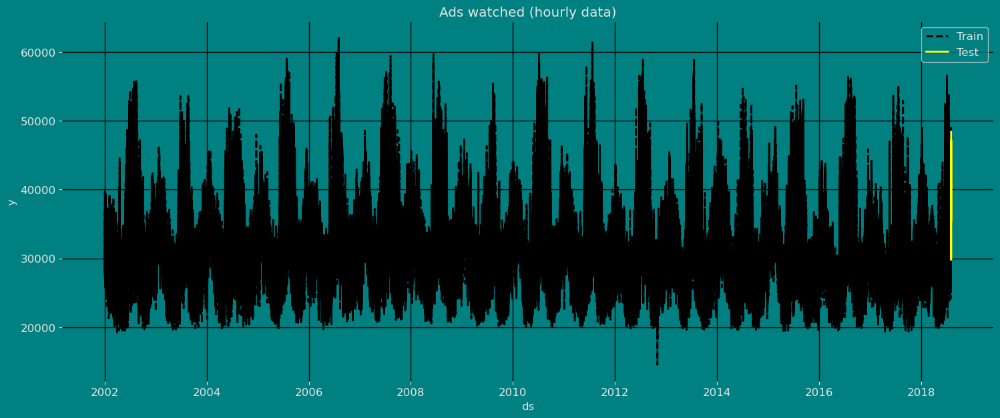

In [58]:
sns.lineplot(train,x="ds", y="y", label="Train", linestyle="--",linewidth=2)
sns.lineplot(test, x="ds", y="y", label="Test", linewidth=2, color="yellow")
plt.title("Ads watched (hourly data)");
plt.show()

# **7. Implementation of `ADIDA Model` with StatsForecast** <a class="anchor" id="7"></a>

[Table of Contents](#0.1)

To also know more about the parameters of the functions of the `ADIDA Model` you can see it [here](https://nixtla.github.io/statsforecast/src/core/models.html#adida).

## **7.1 Load libraries**

In [60]:
from statsforecast import StatsForecast
from statsforecast.models import ADIDA

In [61]:
?ADIDA

Init signature: ADIDA(alias: str = 'ADIDA')
Docstring:      <no docstring>
Init docstring:
ADIDA model.

Aggregate-Dissagregate Intermittent Demand Approach: Uses temporal aggregation to reduce the
number of zero observations. Once the data has been agregated, it uses the optimized SES to
generate the forecasts at the new level. It then breaks down the forecast to the original
level using equal weights.

ADIDA specializes on sparse or intermittent series are series with very few non-zero observations.
They are notoriously hard to forecast, and so, different methods have been developed
especifically for them.

**References:**<br>
[Nikolopoulos, K., Syntetos, A. A., Boylan, J. E., Petropoulos, F., & Assimakopoulos, V. (2011). An aggregate–disaggregate intermittent demand approach (ADIDA) to forecasting: an empirical proposition and analysis. Journal of the Operational Research Society, 62(3), 544-554.](https://researchportal.bath.ac.uk/en/publications/an-aggregate-disaggregate-intermitte

## **7.2 Building Model**
Import and instantiate the models. Setting the argument is sometimes tricky. This article on [Seasonal periods](https://robjhyndman.com/hyndsight/seasonal-periods/) by the master, Rob Hyndmann, can be useful for `season_length`.


In [62]:
season_length = 24*365 # Hourly data 
horizon = len(test) # number of predictions

# We call the model that we are going to use
models = [ADIDA()]
          

We fit the models by instantiating a new StatsForecast object with the following parameters:

models: a list of models. Select the models you want from models and import them.

* `freq:` a string indicating the frequency of the data. (See [panda’s available frequencies](https://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html#offset-aliases).)

* `n_jobs:` n_jobs: int, number of jobs used in the parallel processing, use -1 for all cores.

* `fallback_model:` a model to be used if a model fails.

Any settings are passed into the constructor. Then you call its fit method and pass in the historical data frame.

In [63]:
# Instantiate StatsForecast class as sf
sf = StatsForecast(df=df,
                   models=models,
                   freq='H', 
                   n_jobs=-1)

## **7.3 Fit the Model**

In [64]:
# fit the models
sf.fit()

StatsForecast(models=[ADIDA])

Let's see the results of our `ADIDA Model`. We can observe it with the following instruction:

In [65]:
result=sf.fitted_[0,0].model_
result

{'mean': array([40169.938], dtype=float32)}

## **7.4 Forecast Method**

If you want to gain speed in productive settings where you have multiple series or models we recommend using the `StatsForecast.forecast` method instead of `.fit` and `.predict`.

The main difference is that the `.forecast` doest not store the fitted values and is highly scalable in distributed environments.

The forecast method takes two arguments: forecasts next `h` (horizon) and `level`.

* `h (int):` represents the forecast h steps into the future. In this case, 30 hours ahead.

* `level (list of floats):` this optional parameter is used for probabilistic forecasting. Set the level (or confidence percentile) of your prediction interval. For example, `level=[90]` means that the model expects the real value to be inside that interval 90% of the times.

The forecast object here is a new data frame that includes a column with the name of the model and the y hat values, as well as columns for the uncertainty intervals. Depending on your computer, this step should take around 1min. (If you want to speed things up to a couple of seconds, remove the AutoModels like `ARIMA` and `Theta`)

In [75]:
# Prediction
Y_hat = sf.forecast(horizon )

Y_hat

,ds,ADIDA
unique_id,,
1,2018-08-03 01:00:00,40169.9375
1,2018-08-03 02:00:00,40169.9375
1,2018-08-03 03:00:00,40169.9375
1,2018-08-03 04:00:00,40169.9375
1,2018-08-03 05:00:00,40169.9375
1,2018-08-03 06:00:00,40169.9375
1,2018-08-03 07:00:00,40169.9375
1,2018-08-03 08:00:00,40169.9375
1,2018-08-03 09:00:00,40169.9375


In [77]:
sf.forecast(h=horizon, level=[95])

,ds,ADIDA
unique_id,,
1,2018-08-03 01:00:00,40169.9375
1,2018-08-03 02:00:00,40169.9375
1,2018-08-03 03:00:00,40169.9375
1,2018-08-03 04:00:00,40169.9375
1,2018-08-03 05:00:00,40169.9375
1,2018-08-03 06:00:00,40169.9375
1,2018-08-03 07:00:00,40169.9375
1,2018-08-03 08:00:00,40169.9375
1,2018-08-03 09:00:00,40169.9375


In [78]:
Y_hat=Y_hat.reset_index()
Y_hat

,unique_id,ds,ADIDA
0,1,2018-08-03 01:00:00,40169.9375
1,1,2018-08-03 02:00:00,40169.9375
2,1,2018-08-03 03:00:00,40169.9375
3,1,2018-08-03 04:00:00,40169.9375
4,1,2018-08-03 05:00:00,40169.9375
5,1,2018-08-03 06:00:00,40169.9375
6,1,2018-08-03 07:00:00,40169.9375
7,1,2018-08-03 08:00:00,40169.9375
8,1,2018-08-03 09:00:00,40169.9375
9,1,2018-08-03 10:00:00,40169.9375


In [79]:
# Merge the forecasts with the true values
#Y_hat1 = df.merge(Y_hat, how='left', on=['unique_id', 'ds'])
Y_hat1 = pd.concat([df,Y_hat],  keys=['unique_id', 'ds'])
Y_hat1

ds        y unique_id       ADIDA
unique_id 0  2002-01-01 01:00:00  30393.0         1         NaN
          1  2002-01-01 02:00:00  29265.0         1         NaN
          2  2002-01-01 03:00:00  28357.0         1         NaN
          3  2002-01-01 04:00:00  27899.0         1         NaN
          4  2002-01-01 05:00:00  28057.0         1         NaN
...                          ...      ...       ...         ...
ds        25 2018-08-04 02:00:00      NaN         1  40169.9375
          26 2018-08-04 03:00:00      NaN         1  40169.9375
          27 2018-08-04 04:00:00      NaN         1  40169.9375
          28 2018-08-04 05:00:00      NaN         1  40169.9375
          29 2018-08-04 06:00:00      NaN         1  40169.9375

[145422 rows x 4 columns]

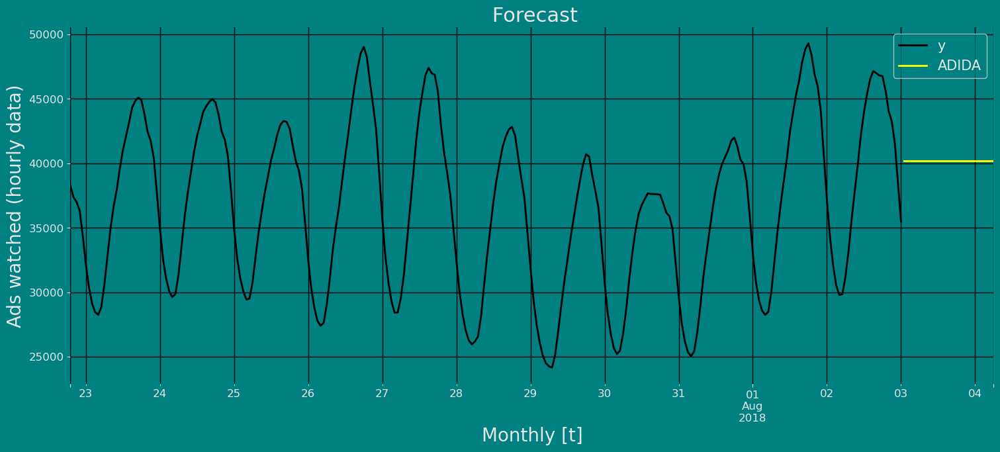

In [82]:
# Merge the forecasts with the true values


fig, ax = plt.subplots(1, 1)
plot_df = pd.concat([train, Y_hat1]).set_index('ds').tail(300)
plot_df['y'].plot(ax=ax, linewidth=2)
plot_df[ "ADIDA"].plot(ax=ax, linewidth=2, color="yellow")
ax.set_title(' Forecast', fontsize=22)
ax.set_ylabel('Ads watched (hourly data)', fontsize=20)
ax.set_xlabel('Monthly [t]', fontsize=20)
ax.legend(prop={'size': 15})
ax.grid(True)

## **7.5 Predict method with confidence interval**

To generate forecasts use the predict method.

The predict method takes two arguments: forecasts the next `h` (for horizon) and `level`.

* `h (int):` represents the forecast h steps into the future. In this case, 12 months ahead.

* `level (list of floats):` this optional parameter is used for probabilistic forecasting. Set the level (or confidence percentile) of your prediction interval. For example, `level=[95]` means that the model expects the real value to be inside that interval 95% of the times.

The forecast object here is a new data frame that includes a column with the name of the model and the y hat values, as well as columns for the uncertainty intervals.

This step should take less than 1 second.

In [83]:
sf.predict(h=horizon)

,ds,ADIDA
unique_id,,
1,2018-08-03 01:00:00,40169.9375
1,2018-08-03 02:00:00,40169.9375
1,2018-08-03 03:00:00,40169.9375
1,2018-08-03 04:00:00,40169.9375
1,2018-08-03 05:00:00,40169.9375
1,2018-08-03 06:00:00,40169.9375
1,2018-08-03 07:00:00,40169.9375
1,2018-08-03 08:00:00,40169.9375
1,2018-08-03 09:00:00,40169.9375


In [84]:
forecast_df = sf.predict(h=horizon, level=[80,95]) 

forecast_df

,ds,ADIDA
unique_id,,
1,2018-08-03 01:00:00,40169.9375
1,2018-08-03 02:00:00,40169.9375
1,2018-08-03 03:00:00,40169.9375
1,2018-08-03 04:00:00,40169.9375
1,2018-08-03 05:00:00,40169.9375
1,2018-08-03 06:00:00,40169.9375
1,2018-08-03 07:00:00,40169.9375
1,2018-08-03 08:00:00,40169.9375
1,2018-08-03 09:00:00,40169.9375


We can join the forecast result with the historical data using the pandas function `pd.concat()`, and then be able to use this result for graphing.

In [85]:
pd.concat([df, forecast_df]).set_index('ds')

,y,unique_id,ADIDA
ds,,,
2002-01-01 01:00:00,30393.0,1,NaN
2002-01-01 02:00:00,29265.0,1,NaN
2002-01-01 03:00:00,28357.0,1,NaN
2002-01-01 04:00:00,27899.0,1,NaN
2002-01-01 05:00:00,28057.0,1,NaN
...,...,...,...
2018-08-04 02:00:00,NaN,NaN,40169.9375
2018-08-04 03:00:00,NaN,NaN,40169.9375
2018-08-04 04:00:00,NaN,NaN,40169.9375


In [86]:
df_plot= pd.concat([df, forecast_df]).set_index('ds')
df_plot

,y,unique_id,ADIDA
ds,,,
2002-01-01 01:00:00,30393.0,1,NaN
2002-01-01 02:00:00,29265.0,1,NaN
2002-01-01 03:00:00,28357.0,1,NaN
2002-01-01 04:00:00,27899.0,1,NaN
2002-01-01 05:00:00,28057.0,1,NaN
...,...,...,...
2018-08-04 02:00:00,NaN,NaN,40169.9375
2018-08-04 03:00:00,NaN,NaN,40169.9375
2018-08-04 04:00:00,NaN,NaN,40169.9375


Now let's visualize the result of our forecast and the historical data of our time series, also let's draw the confidence interval that we have obtained when making the prediction with 95% confidence.

In [87]:
def plot_forecasts(y_hist, y_pred, models):
    _, ax = plt.subplots(1, 1, figsize = (20, 7))
    #y_true = y_true.merge(y_pred, how='left', on=['unique_id', 'ds'])
    df_plot = pd.concat([y_hist, y_pred]).set_index('ds').tail(12*10)
    df_plot[['y'] + models].plot(ax=ax, linewidth=3 , )
    colors = ['green', "lime"]
  # Specify graph features:
    ax.fill_between(df_plot.index, 
                df_plot['Add-lo-80'], 
                df_plot['Add-hi-80'],
                alpha=.20,
                color='fuchsia',
                label='HoltWinter_level_80')
    ax.fill_between(df_plot.index, 
                df_plot['Add-lo-95'], 
                df_plot['Add-hi-95'],
                alpha=.3,
                color='lime',
                label='HoltWinter_level_95')
    ax.set_title('', fontsize=22)
    ax.set_ylabel("Ads watched (hourly data)", fontsize=20)
    ax.set_xlabel('Hourly', fontsize=20)
    ax.legend(prop={'size': 20})
    ax.grid(True)
    plt.show()

KeyError: 'Add-lo-80'

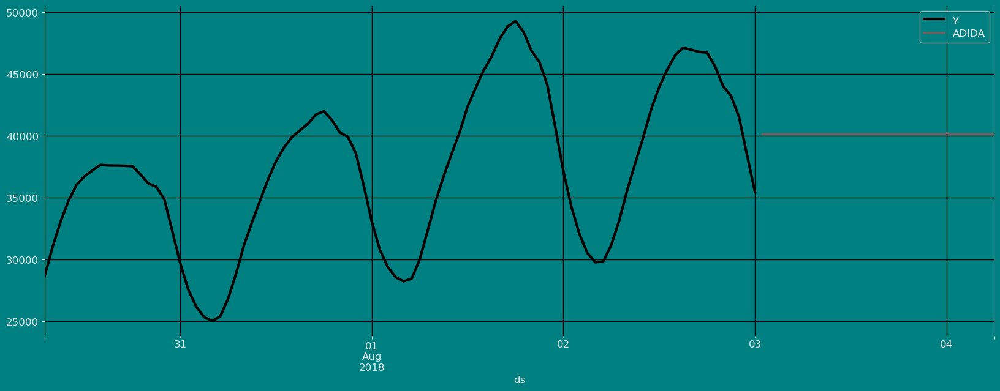

In [88]:
plot_forecasts(df, forecast_df, models=["ADIDA"])

Let's plot the same graph using the plot function that comes in `Statsforecast`, as shown below.

In [89]:
sf.plot(df, forecast_df)

TypeError: '<' not supported between instances of 'float' and 'str'

# **8. Evaluate the model’s performance** <a class="anchor" id="8"></a>

[Table of Contents](#0.1)

In previous steps, we’ve taken our historical data to predict the future. However, to asses its accuracy we would also like to know how the model would have performed in the past. To assess the accuracy and robustness of your models on your data perform Cross-Validation.

With time series data, Cross Validation is done by defining a sliding window across the historical data and predicting the period following it. This form of cross-validation allows us to arrive at a better estimation of our model’s predictive abilities across a wider range of temporal instances while also keeping the data in the training set contiguous as is required by our models.

The following graph depicts such a Cross Validation Strategy:

![](https://raw.githubusercontent.com/Nixtla/statsforecast/main/nbs/imgs/ChainedWindows.gif)

## **8.1 Perform time series cross-validation**

Cross-validation of time series models is considered a best practice but most implementations are very slow. The statsforecast library implements cross-validation as a distributed operation, making the process less time-consuming to perform. If you have big datasets you can also perform Cross Validation in a distributed cluster using Ray, Dask or Spark.

In this case, we want to evaluate the performance of each model for the last 5 months `(n_windows=)`, forecasting every second months `(step_size=12)`. Depending on your computer, this step should take around 1 min.

The cross_validation method from the StatsForecast class takes the following arguments.

* `df:` training data frame

* `h (int):` represents h steps into the future that are being forecasted. In this case, 12 months ahead.

* `step_size (int):` step size between each window. In other words: how often do you want to run the forecasting processes.

* `n_windows(int):` number of windows used for cross validation. In other words: what number of forecasting processes in the past do you want to evaluate.

In [90]:
crossvalidation_df = sf.cross_validation(df=df,
                                         h=horizon,
                                         step_size=30,
                                         n_windows=3)

The crossvaldation_df object is a new data frame that includes the following columns:

* `unique_id:` index. If you dont like working with index just run `crossvalidation_df.resetindex()`.
* `ds:` datestamp or temporal index
* `cutoff:` the last datestamp or temporal index for the `n_windows`.
* `y:` true value
* `model:` columns with the model’s name and fitted value.

In [91]:
crossvalidation_df

,ds,cutoff,y,ADIDA
unique_id,,,,
1,2018-07-30 07:00:00,2018-07-30 06:00:00,28676.0,27211.822266
1,2018-07-30 08:00:00,2018-07-30 06:00:00,31050.0,27211.822266
1,2018-07-30 09:00:00,2018-07-30 06:00:00,33081.0,27211.822266
1,2018-07-30 10:00:00,2018-07-30 06:00:00,34779.0,27211.822266
1,2018-07-30 11:00:00,2018-07-30 06:00:00,36060.0,27211.822266
...,...,...,...,...
1,2018-08-02 20:00:00,2018-08-01 18:00:00,44057.0,46850.734375
1,2018-08-02 21:00:00,2018-08-01 18:00:00,43256.0,46850.734375
1,2018-08-02 22:00:00,2018-08-01 18:00:00,41552.0,46850.734375


We’ll now plot the forecast for each cutoff period. To make the plots clearer, we’ll rename the actual values in each period.

In [92]:
cross_validation=crossvalidation_df.copy()
cross_validation.rename(columns = {'y' : 'actual'}, inplace = True) # rename actual values 

cutoff = cross_validation['cutoff'].unique()

for k in range(len(cutoff)): 
    cv = cross_validation[cross_validation['cutoff'] == cutoff[k]]
    StatsForecast.plot(df, cv.loc[:, cv.columns != 'cutoff'])

TypeError: '<' not supported between instances of 'float' and 'str'

# **9. Evaluate the model** <a class="anchor" id="9"></a>

[Table of Contents](#0.1)

We can now compute the accuracy of the forecast using an appropiate accuracy metric. Here we’ll use the Root Mean Squared Error (RMSE). To do this, we first need to `install datasetsforecast`, a Python library developed **by Nixtla** that includes a function to compute the RMSE.

`pip install datasetsforecast`

In [93]:
from datasetsforecast.losses import rmse

The function to compute the RMSE takes two arguments:

1. The actual values.
2. The forecasts, in this case, `Holt Winters Model`.

In [ ]:
rmse = rmse(crossvalidation_df['actual'], crossvalidation_df["DynamicOptimizedTheta"])
print("RMSE using cross-validation: ", rmse)

# **10. References** <a class="anchor" id="10"></a>

[Table of Contents](#0)

1. Changquan Huang • Alla Petukhina. Springer series (2022). Applied Time Series Analysis and Forecasting with Python. 
2. Ivan Svetunkov. [Forecasting and Analytics with the Augmented Dynamic Adaptive Model (ADAM)](https://openforecast.org/adam/)
3. [James D. Hamilton. Time Series Analysis Princeton University Press, Princeton, New Jersey, 1st Edition, 1994.](https://press.princeton.edu/books/hardcover/9780691042893/time-series-analysis)
4. [Nixtla Parameters](https://nixtla.github.io/statsforecast/src/core/models.html#arch-model).
5. [Pandas available frequencies](https://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html#offset-aliases).
6. [Rob J. Hyndman and George Athanasopoulos (2018). “Forecasting principles and practice, Time series cross-validation”.](https://otexts.com/fpp3/tscv.html).
7. [Seasonal periods- Rob J Hyndman](https://robjhyndman.com/hyndsight/seasonal-periods/).